# Motion Analysis - Object Tracking

## 1. Introduction

The goal of this exercise is to get familizar with the basic concepts of visual object tracking. As in the lectures, we will focus on model-free single-object online, we will analyze the video sequence frame by frame and localize the target object. We will visualize the results using Matplotlib. The last part of the exercise will also look at the basics of performance evaluation of tracking algorithms.

We will be using all the libraries that you are already familiar with: OpenCV, NumPy and Matplotlib.

In [8]:
import cv2
import math
import numpy as np
import matplotlib.pyplot as plt

## 2. Read the video and visualize the frames

In this task, we will read a video file and visualize the first few frames. We will use OpenCV to read the video and Matplotlib to display the frames. A suitable video files are provided in the `data` folder. As it is common in computer vision (for compatibility and reproducibility reasons), videos are stored on per-frame basis, each frame is a separate image file. We will use a simple loader that scans the folder and loads the images in the correct order. 

In [9]:
def load_video(video_path):
    """
    Load a video from a directory and return a list of frames. Each frame is a JPEG image, they are numbered with zero padded integers.
    """
    import cv2
    import os

    i = 1
    
    video = []
    
    while True:
        image_path = os.path.join(video_path, f"{i:08d}.jpg")
        if not os.path.exists(image_path):
            break
        image = cv2.imread(image_path)
        if image is None:
            break
        video.append(image)
        i += 1
        
    return video


Use the function above to load the video frames and display every tenth frame using Matplotlib. You can use the `imshow` function to display the images and `subplots` to create a grid of images. Make sure to set the title of each subplot to indicate the frame number.

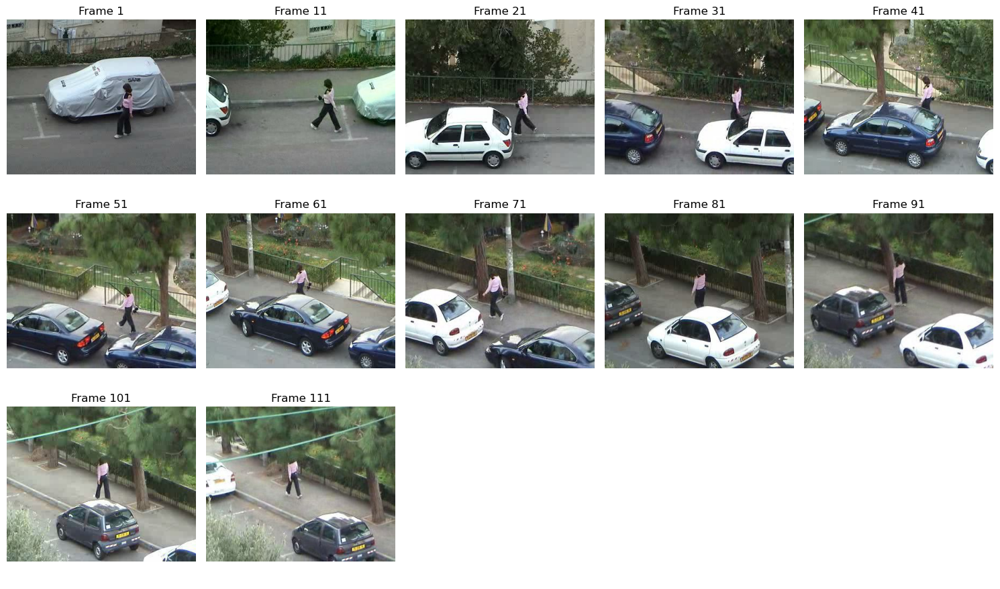

In [3]:
video_path = "data/woman"       # adjust to your path
frames = load_video(video_path)

# pick every 10th frame
sel_frames = frames[::50]
n = len(sel_frames)

# determine grid size (e.g. up to 5 columns)
cols = 5
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(cols*3, rows*3))
axes = axes.flatten()

for idx, frame in enumerate(sel_frames):
    # convert BGR (OpenCV) to RGB (Matplotlib)
    rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    axes[idx].imshow(rgb)
    axes[idx].set_title(f"Frame {(idx*10)+1}")
    axes[idx].axis("off")

# hide any unused subplots
for ax in axes[n:]:
    ax.axis("off")

plt.tight_layout()
plt.show()

To perceive the motion in the video we will also visualize it in a loop. We will add `plt.pause(0.1)` to create an animation effect.

In [10]:

import cv2
import numpy as np
import matplotlib.pyplot as plt

from IPython.display import display, Image
import threading
import time

class VideoViewer:
    """This class can be used to display video frame by frame in a Jupyter notebook."""

    def __init__(self, timeout = 2, clear = False):
        """
        :param timeout: Timeout in seconds after which the video display is stopped if no new frame is received.
        :param clear: If True, the video display is cleared after the last frame is received.
        """
        self._frame = None
        self._thread = None
        self._last_update = 0
        self._timeout = timeout
        self._clear = clear
        self._display_handle = display(None, display_id=True)
        self._mutex = threading.Lock()

    def _view(self):
        import time
        self._last_update = time.time()
        while True:
            with self._mutex:
                if self._frame is None:
                    if time.time() - self._last_update > self._timeout:
                        break
                    else:
                        continue
                try:
                    self._display_handle.update(Image(data=cv2.imencode('.jpeg', self._frame)[1].tobytes()))
                finally:
                    pass
                self._frame = None
                self._last_update = time.time()
            time.sleep(0.1)

        if self._clear:
            self._display_handle.update(None)
        self._thread = None

    def show(self, frame):
        """ Display a frame. If the previous frame has not been displayed yet, it is dropped. """
        with self._mutex:
            self._frame = frame
        if self._thread is None:
            self._thread = threading.Thread(target=self._view, args=())
            self._thread.start()

    def play(self, frames):
        try:
            for frame in frames:
                self.show(frame)
                time.sleep(0.1)
        except KeyboardInterrupt:
            pass




In [11]:
video = load_video("data/woman/")

player = VideoViewer()
#player.play(video)

None

## 3. Tracking using Template Matching

In this task we will implement a simple object tracking algorithm using template matching. We will match the object reference patch to the search region in each new frame. 

We will select a region of interest (ROI) in the first frame and use it as a template to track the object in subsequent frames. We will visualize the tracking results by drawing a rectangle around the detected object in each frame.

The first thing that we will do is to define a class interface for a tracker. A tracker is a stateful algorithm, so OOP is a good fit. We will define a class `Tracker` with the following methods:
- `initialize(self, frame: np.ndarray, bounding_box: Tuple[int, int, int, int])`: constructor that takes an image and a bounding box as input. The bounding box is a tuple of four integers (x, y, width, height) that defines the region of interest in the image.
- `update(self, frame: np.ndarray)`: method that takes a new frame as input and returns the updated position of the object in the frame.
- `draw(self, frame: np.ndarray)`: method that takes a new frame as input and draws a rectangle around the detected object in the frame.
- `position(self)`: method that returns the current position of the object in the frame.

Even though Python is a dynamically typed language and does not require base classes, we will use this abstract class as a base class for our tracker. This will allow us to easily switch between different tracking algorithms in the future. 

In [12]:

class Tracker:
    def __init__(self):
        pass
    
    def initialize(self, frame, bbox):
        pass
    
    def update(self, frame):
        pass
    
    def draw(self, frame):
        pass
    
    def position(self):
        pass

Now, we will first try out cutting a reference patch from the first frame and visualize it.  Load the `bicycle` sequence and cut a patch from the first frame for the bounding box (x, y, width, height) = (154.0,94.0,18.0,48.0). Keep in mind that we will work in grayscale this time, so convert the image to grayscale using `cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)`. Use the `imshow` function to display the patch.

**Note:** The bounding box is defined as (x, y, width, height), where (x, y) is the top-left corner of the bounding box. Be careful with the order of the coordinates when slicing the image.

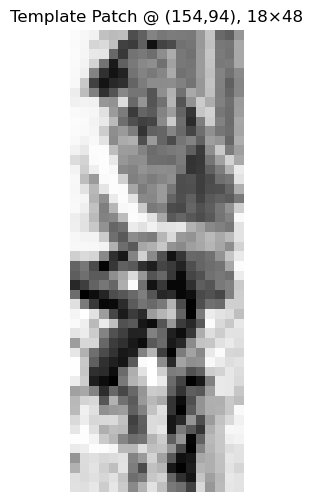

In [13]:
video_path = "data/bicycle"
frames = load_video(video_path)

first_frame = frames[0]
gray = cv2.cvtColor(first_frame, cv2.COLOR_BGR2GRAY)

x, y, w, h = (154, 94, 18, 48)
patch = gray[y : y + h, x : x + w]

plt.figure(figsize=(4,6))
plt.imshow(patch, cmap="gray")
plt.title(f"Template Patch @ ({x},{y}), {w}×{h}")
plt.axis("off")
plt.show()

In the future we will crop the patches using the following code that will pad the patch with zeros if it is out of the image bounds.


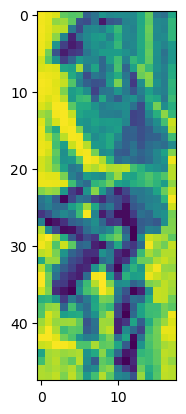

In [14]:
# I am giving you this function so that you will not waste time on debugging index problems. Mind that it is likely not perfect.

def get_patch(image, bbox, replicate=True):
    
    # Test if image is grayscale
    assert len(image.shape) == 2, "Image must be grayscale"
    
    x0 = round(bbox[0])
    y0 = round(bbox[1])
    x1 = int(round(x0 + bbox[2]))
    y1 = int(round(y0 + bbox[3]))
    
    # move on the edge if patch is out of image
    if x0 >= image.shape[1]:
        x0 = image.shape[1] - 1
        x1 = int(round(x0 + bbox[2]))
    if y0 >= image.shape[0]:
        y0 = image.shape[0] - 1
        y1 = int(round(y0 + bbox[3]))
    if x1 <= 0:
        x1 = 1
        x0 = -int(round(bbox[0])) + 1
    if y1 <= 0:
        y1 = 1
        y0 = -int(round(bbox[1])) + 1

    # Padding
    x0_pad = max(0, -x0)
    x1_pad = max(x1 - image.shape[1] + 1, 0)
    y0_pad = max(0, -y0)
    y1_pad = max(y1 - image.shape[0] + 1, 0)

    # Crop target
    patch = image[y0 + y0_pad:y1 - y1_pad, x0 + x0_pad:x1 - x1_pad]
    if patch.shape[0] == 0 or patch.shape[1] == 0:
        return np.zeros((int(bbox[3]), int(bbox[2])), dtype=image.dtype)
    return cv2.copyMakeBorder(patch, y0_pad, y1_pad, x0_pad, x1_pad, cv2.BORDER_REPLICATE if replicate else cv2.BORDER_CONSTANT, value=0)

plt.imshow(get_patch(gray, (154, 94, 18, 48)))

We can now try to match the patch to the same frame using the `cv2.matchTemplate` function. This function takes the image, the template, and the matching method as input and returns a result matrix. The result matrix contains the correlation coefficients for each pixel in the image. Experiment with different matching methods and visualize the result using `imshow`. You can use the `cv2.minMaxLoc` function to find the best match in the result matrix. This function returns the minimum and maximum values and their locations in the result matrix. Use this information to draw a rectangle around the detected object in the image. Use `cv2.rectangle` to draw the rectangle and `imshow` to display the image.

**Question**: What is the best matching method for this task? Why?

**Question**: What is the effect of the size of the template on the matching result? Try to change the size of the template and see how it affects the matching result.

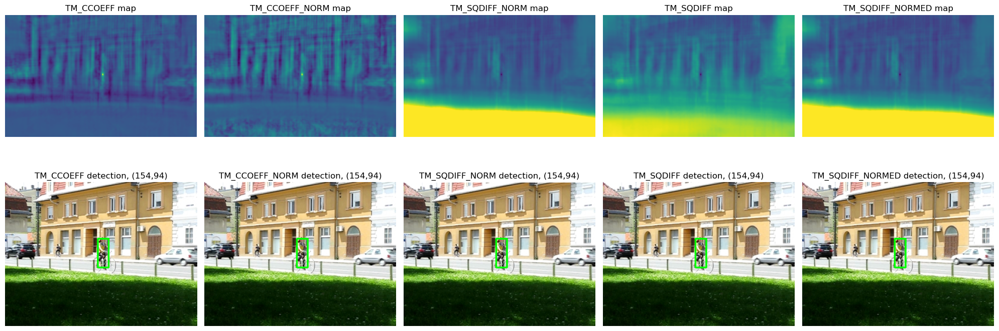

In [15]:
video_path = "data/bicycle"
frames = load_video(video_path)
first_gray = cv2.cvtColor(frames[0], cv2.COLOR_BGR2GRAY)

bbox = (154, 94, 18, 48)
template_small = get_patch(first_gray, bbox)

cx, cy = bbox[0] + bbox[2]/2, bbox[1] + bbox[3]/2
big_bbox = (cx - bbox[2], cy - bbox[3], bbox[2]*2, bbox[3]*2)
template_large = get_patch(first_gray, big_bbox)

methods = {
    "TM_CCOEFF":      cv2.TM_CCOEFF,
    "TM_CCOEFF_NORM": cv2.TM_CCOEFF_NORMED,
    "TM_SQDIFF_NORM": cv2.TM_SQDIFF_NORMED,
    "TM_SQDIFF"     : cv2.TM_SQDIFF,
    "TM_SQDIFF_NORMED":cv2.TM_SQDIFF_NORMED
}

fig, axes = plt.subplots(2, len(methods), figsize=(4*len(methods), 8))
for col, (name, meth) in enumerate(methods.items()):
    # run matchTemplate
    res = cv2.matchTemplate(first_gray, template_small, meth)
    min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(res)
    
    if meth in (cv2.TM_SQDIFF, cv2.TM_SQDIFF_NORMED):
        best_loc = min_loc
    else:
        best_loc = max_loc
    
    detect_img = frames[0].copy()
    top_left = best_loc
    bottom_right = (top_left[0] + template_small.shape[1],
                    top_left[1] + template_small.shape[0])
    cv2.rectangle(detect_img, top_left, bottom_right, (0,255,0), 2)
    
    axes[0, col].imshow(res, cmap="viridis")
    axes[0, col].set_title(f"{name} map")
    axes[0, col].axis("off")
    
    axes[1, col].imshow(cv2.cvtColor(detect_img, cv2.COLOR_BGR2RGB))
    axes[1, col].set_title(f"{name} detection, ({top_left[0]},{top_left[1]})")
    axes[1, col].axis("off")

plt.tight_layout()
plt.show()

**Question**: What is the best matching method for this task? Why?

> All gave the same result, `top_left=(154,94)`

**Question**: What is the effect of the size of the template on the matching result? Try to change the size of the template and see how it affects the matching result.

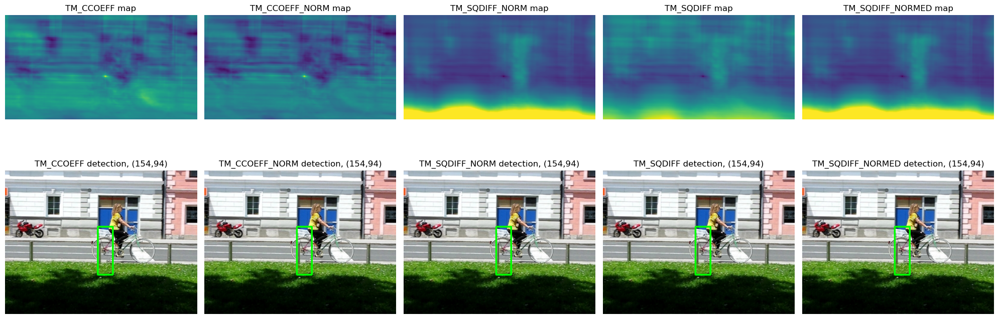

In [16]:
video_path = "data/bicycle"
frames = load_video(video_path)
N = 100
tenth_gray = cv2.cvtColor(frames[N], cv2.COLOR_BGR2GRAY)

bbox = (154, 94, 25, 80)
template_small = get_patch(tenth_gray, bbox)

fig, axes = plt.subplots(2, len(methods), figsize=(4*len(methods), 8))
for col, (name, meth) in enumerate(methods.items()):
    # run matchTemplate
    res = cv2.matchTemplate(tenth_gray, template_small, meth)
    min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(res)
    
    if meth in (cv2.TM_SQDIFF, cv2.TM_SQDIFF_NORMED):
        best_loc = min_loc
    else:
        best_loc = max_loc
    
    detect_img = frames[N].copy()
    top_left = best_loc
    bottom_right = (top_left[0] + template_small.shape[1],
                    top_left[1] + template_small.shape[0])
    cv2.rectangle(detect_img, top_left, bottom_right, (0,255,0), 2)
    
    axes[0, col].imshow(res, cmap="viridis")
    axes[0, col].set_title(f"{name} map")
    axes[0, col].axis("off")
    
    axes[1, col].imshow(cv2.cvtColor(detect_img, cv2.COLOR_BGR2RGB))
    axes[1, col].set_title(f"{name} detection, ({top_left[0]},{top_left[1]})")
    axes[1, col].axis("off")

plt.tight_layout()
plt.show()

Once you have your template matching working, you can implement the `Tracker` class. The `initialize` method should take the first frame and the bounding box as input and store them as instance variables. The `update` method should take a new frame as input and use the `cv2.matchTemplate` function to find the best match for the template in the new frame. The `draw` method should draw a rectangle around the detected object in the new frame. The `position` method should return the current position of the object in the frame.

In [17]:
class TemplateTracker(Tracker):
    """
    Very simple *fixed-template* tracker that slides the reference patch
    over each new frame with cv2.matchTemplate.
    """

    def __init__(self, method=cv2.TM_CCOEFF_NORMED):
        super().__init__()
        self.method = method            # matching cost function
        self.template = None            # reference patch (grayscale)
        self.bbox = None                # last known (x, y, w, h)

    # -------------------------------------------------------------
    # 1. Boot-strap the tracker with the first frame + ground truth bbox
    # -------------------------------------------------------------
    def initialize(self, frame, bbox):
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        self.template = get_patch(gray, bbox)
        self.bbox = tuple(map(int, bbox))   # force ints for safety

    # -------------------------------------------------------------
    # 2. Slide the template on the next frame and update bbox
    # -------------------------------------------------------------
    def update(self, frame):
        assert self.template is not None, "Call initialize() first!"
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        res = cv2.matchTemplate(gray, self.template, self.method)
        min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(res)

        # best match depends on method
        if self.method in (cv2.TM_SQDIFF, cv2.TM_SQDIFF_NORMED):
            top_left = min_loc
        else:
            top_left = max_loc

        x, y = top_left
        w, h = self.template.shape[1], self.template.shape[0]
        self.bbox = (x, y, w, h)
        return self.bbox

    # -------------------------------------------------------------
    # 3. Draw rectangle on a copy – return it so user can display/save
    # -------------------------------------------------------------
    def draw(self, frame, color=(0, 255, 0), thickness=2):
        if self.bbox is None:
            return frame
        x, y, w, h = self.bbox
        cv2.rectangle(frame, (x, y), (x + w, y + h), color, thickness)
        return frame

    # -------------------------------------------------------------
    # 4. Current (x, y, w, h)
    # -------------------------------------------------------------
    def position(self):
        return self.bbox


We can now try running our tracker on the `bicycle` sequence. Load the video frames and create an instance of the `Tracker` class. Use a loop to read each frame and call the `update` method to update the position of the object. Use the `draw` method to draw a rectangle around the detected object in each frame. Use `imshow` to display the image and `plt.pause(0.1)` to create an animation effect.

**Question**: The tracker is not very robust, it fails soon, why is that? What can we do to improve it?

In [20]:
# video_path = "data/bicycle"
# frames = load_video(video_path)
# N = 250
# bbox = tracker.update(frames[N])
# tracker.draw(frames[N])

# fig, ax = plt.subplots(figsize=(6, 6))

# ax.imshow(cv2.cvtColor(frames[N], cv2.COLOR_BGR2RGB))
# plt.show()


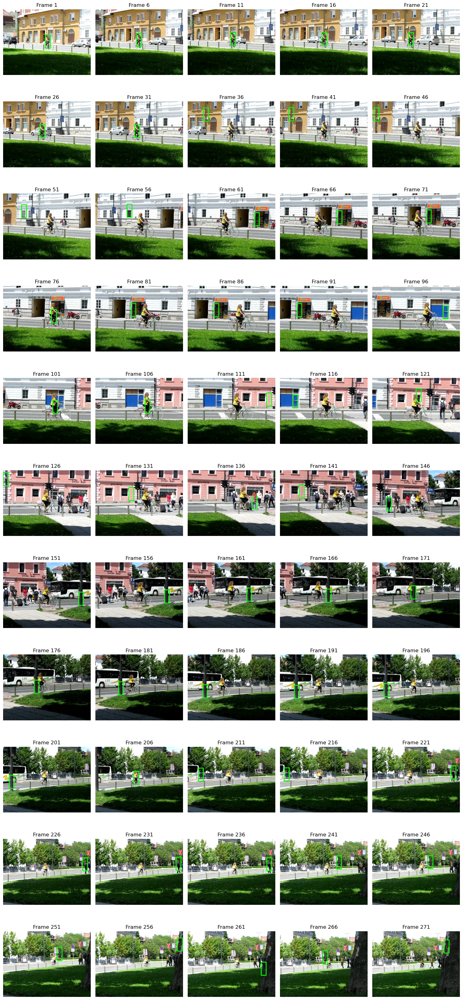

In [21]:
video_path = "data/bicycle"
frames     = load_video(video_path)

tracker    = TemplateTracker()
tracker.initialize(frames[0], (154, 94, 18, 48))

vis = []
for i, frame in enumerate(frames):
    tracker.update(frame)
    if i % 5 == 0:                                # keep every 5-th frame
        drawn = tracker.draw(frame.copy())
        vis.append(cv2.cvtColor(drawn, cv2.COLOR_BGR2RGB))

cols, rows = 5, math.ceil(len(vis)/5)
fig, axes  = plt.subplots(rows, cols, figsize=(cols*3, rows*3))
axes = axes.flatten()

for idx, img in enumerate(vis):
    axes[idx].imshow(img)
    axes[idx].set_title(f"Frame {idx*5+1}")
    axes[idx].axis("off")
for ax in axes[len(vis):]:
    ax.axis("off")

plt.tight_layout()
plt.show()


### **Analysis:**

The tracker does a good job only for about the first 30 frames, then it completly detects other objects.

> The template tracker cannot handle changes in scale very well

## 4. Correlation Filters for Object Tracking

In this task, we will implement a more advanced object tracking algorithm using correlation filters. A correlation filter is a discriminative model that learns to distinguish between the target object and the (close) background. While OpenCV provides built-in class for correlation filter tracking, we will first implement a simple version of it from scratch. In this implementation, w will design a filter based on grayscale image of the object and use it to track the object in the video.

We will again first start with an offline example. Load the `juice` sequence and cut a patch from the first frame for the bounding box (x, y, width, height) = (131,50,36,89). Due to circularity of the filter, we will multiply the patch with a windowing function. We will use a windowing function called Hanning windowing function. It is already implemented in OpenCV under the name `createHanningWindow`. Apply the windowing function to the patch and visualize the result.

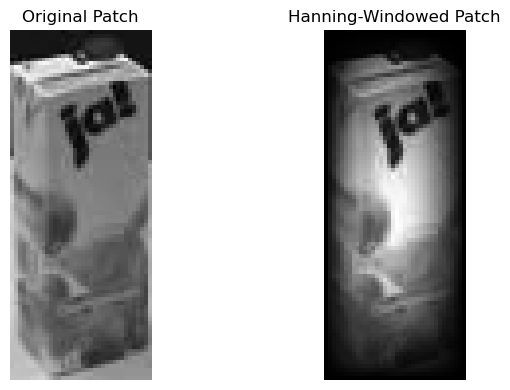

In [22]:

# 1. Load juice frames and pick first
juice_path = "data/juice"        # adjust to your folder
frames = load_video(juice_path)
first = frames[0]
gray  = cv2.cvtColor(first, cv2.COLOR_BGR2GRAY)

# 2. Define bbox and extract patch
x, y, w, h = (131, 50, 36, 89)
patch = get_patch(gray, (x, y, w, h))

# 3. Create Hanning window & apply
# Note: window size must match patch size, and use same dtype
hann = cv2.createHanningWindow((w, h), cv2.CV_32F)
# convert patch to float32 so multiplication is correct
patch_f = np.float32(patch) / 255.0
windowed = (patch_f * hann)

# 4. Show original patch vs windowed
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8,4))
ax1.imshow(patch, cmap="gray")
ax1.set_title("Original Patch")
ax1.axis("off")

ax2.imshow(windowed, cmap="gray")
ax2.set_title("Hanning-Windowed Patch")
ax2.axis("off")

plt.tight_layout()
plt.show()


We will now calculate a discriminative filter in the frequency domain. We will use the NumPy `fft` module to calculate the DFT of the patch and the windowing function. The equaltion for a discriminative correlation filter is:
$$
\mathcal{H} = \frac{\mathcal{G} \cdot \mathcal{F}^*}{\mathcal{F} \cdot \mathcal{F}^* + \lambda}
$$
where $\mathcal{G}$ is the desired response, $\mathcal{F}$ is the patch (with windowing function applied), both in frequency domain, and $\lambda$ is a regularization parameter. Operation $(\cdot)^{*}$ denotes the complex conjugate. Our desired response is a Gaussian function with the same size as the patch. The Gaussian function, we will use a provided function called `create_gauss_peak` to generate a suitable form of the reference signal. The function is rolled by half the size of the patch to center it.

To apply the filter to the patch, we will use the following equation:
$$
I = \left(\mathcal{H} \cdot \mathcal{F}\right)^{-1}
$$
where $\mathcal{F}$ is the patch (with windowing function applied), $(\cdot)^{-1}$ is the inverse DFT, and $H$ is the filter. 

Implement the filter calculation and visualize the template (with a windowing applied), the desired output, the calculated filter (in spatial domain) and the resulting response (can be applied to the template itself or another patch).

**Question**: What is the effect of the size of the filter on the result? Try to change the size of the filter and see how it affects the result.

**Question**: What is the effect of the standard deviation of the target response? Why is a sharp response desired?

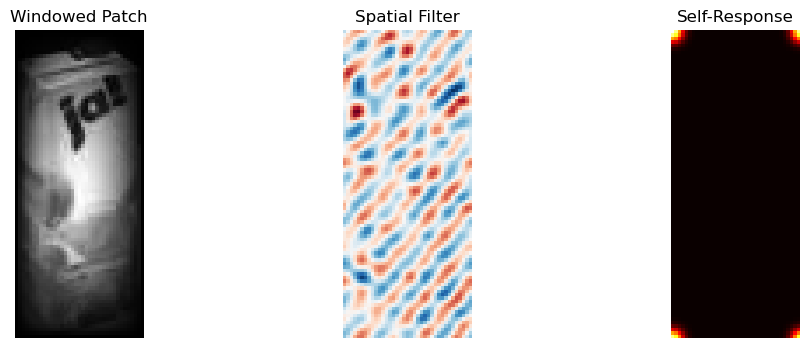

In [23]:
def create_gauss_peak(target_size, sigma):
    # target size is in the format: (width, height)
    # sigma: parameter (float) of the Gaussian function
    # note that sigma should be small so that the function is in a shape of a peak
    # values that make sens are approximately from the interval: ~(0.5, 5)
    # output is a matrix of dimensions: (width, height), it is roll-shifted
    w2 = math.floor(target_size[0] / 2)
    h2 = math.floor(target_size[1] / 2)
    [X, Y] = np.meshgrid(np.arange(-w2, w2 + 1), np.arange(-h2, h2 + 1))
    G = np.exp(-X**2 / (2 * sigma**2) - Y**2 / (2 * sigma**2))
    G = np.roll(G, (-h2, -w2), (0, 1))
    return G
import cv2
import numpy as np
import math
import matplotlib.pyplot as plt

# --- after you get `patch` from get_patch() ---
# ensure odd dimensions by padding if necessary
h, w = patch.shape
pad_bottom = 1 if h % 2 == 0 else 0
pad_right  = 1 if w % 2 == 0 else 0

if pad_bottom or pad_right:
    patch = cv2.copyMakeBorder(
        patch,
        top=0, bottom=pad_bottom,
        left=0, right=pad_right,
        borderType=cv2.BORDER_REPLICATE
    )
    h, w = patch.shape  # now both are odd

# window the (now odd-sized) patch
hann = cv2.createHanningWindow((w, h), cv2.CV_32F)
F = np.float32(patch) * hann

# build your Gaussian peak with matching (w,h)
σ = 2.0
G = create_gauss_peak((w, h), σ)

# now FFTs all have the same shape
Ff = np.fft.fft2(F)
Gf = np.fft.fft2(G)

λ = 0.01
Hf = (Gf * np.conj(Ff)) / (Ff * np.conj(Ff) + λ)

# continue as before…
h_spatial = np.real(np.fft.fftshift(np.fft.ifft2(Hf)))
resp      = np.real(np.fft.ifft2(Hf * Ff))

# visualize
fig, axs = plt.subplots(1, 3, figsize=(12,4))
axs[0].imshow(F, cmap="gray");        axs[0].set_title("Windowed Patch")
axs[1].imshow(h_spatial, cmap="RdBu"); axs[1].set_title("Spatial Filter")
axs[2].imshow(resp, cmap="hot");      axs[2].set_title("Self-Response")
for ax in axs: ax.axis("off")
plt.show()


**Question:** What is the effect of the size of the filter on the result? Try changing the filter size and observe how it alters the output.

**Answer:**

> Larger filters encompass more of the surrounding context, which usually yields a single, well‐defined peak in the correlation response. This is especially valuable in cluttered scenes, as the additional background information helps distinguish the target from its surroundings.

> Smaller filters require less computation and run more quickly, but because they capture less discriminative information, they can produce multiple spurious peaks—particularly if the object’s appearance does not stand out strongly.

> Balance: Choose a filter size that is just large enough to include the object and a minimal amount of background; any extra area simply adds noise and slows down processing.

**Question:** What is the effect of the standard deviation of the target response? Why is a sharp response preferred?

**Answer:**

>Small σ (narrow Gaussian): Produces a very sharp, spike‐like desired response. The correlation filter then focuses strongly on exact alignment, creating a clear maximum but at the cost of reduced robustness to minor shifts or deformations.

>Large σ (wide Gaussian): Generates a broader, flatter peak. The filter becomes more tolerant of small misalignments but sacrifices precision, leading to a more ambiguous response surface.

>Preference for sharpness: In tracking, you need an unmistakable, single peak to localize the object accurately frame by frame. A narrow Gaussian enforces one dominant maximum at the true object center, reducing jitter and avoiding multiple competing peaks.

Now, we will integrate the correlation filter calculation into the object tracking loop. Use the same base class `Tracker` as before, but this time we will implement the `update` method using correlation filters. The `update` method should take a new frame as input and use the correlation filter to find the best match for the template in the new frame. The `draw` method should draw a rectangle around the detected object in the new frame. The `position` method should return the current position of the object in the frame.

In the initialization step, calculate the filter in the frequency domain and store it as an instance variable. In the update step, apply the filter to the new frame and find the best match using the `cv2.minMaxLoc` function.

The filter can be updated through time in a simple way. We can use the following update rule:
$$
h_{t+1} = \alpha h^{\star} + (1 - \alpha) h_t
$$
where $\alpha$ is a parameter that controls the update rate and $h^{\star}$ is the filter, calculated at the position of the object in the current frame. A small value of $\alpha$ will make the filter more robust to noise, while a large value of $\alpha$ will make the filter more sensitive to changes in the object.

In [24]:
class CorrelationTracker:
    def __init__(self, sigma=2., lam=1e-2, alpha=0.125, search_scale=1.0):
        self.sigma, self.lam, self.alpha, self.scale = sigma, lam, alpha, search_scale
        self.Hf = self.hann = self.bbox = self.size = None

    def _ensure_odd_patch(self, p):
        h, w = p.shape
        pad_bottom = 1 if h % 2 == 0 else 0
        pad_right  = 1 if w % 2 == 0 else 0
        if pad_bottom or pad_right:
            p = cv2.copyMakeBorder(
                p, 0, pad_bottom, 0, pad_right,
                cv2.BORDER_REPLICATE
            )
        return p

    def initialize(self, frame, bbox):
        x,y,w,h = map(int,bbox)
        # enlarge search window if scale>1
        sw, sh = int(w*self.scale), int(h*self.scale)
        self.bbox = (x, y, sw, sh)
        self.size = (sh, sw)
        self.hann = cv2.createHanningWindow((sw, sh), cv2.CV_32F)
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        patch = self._ensure_odd_patch(get_patch(gray, self.bbox))
        h, w  = patch.shape
        self.hann = cv2.createHanningWindow((w, h), cv2.CV_32F)
        Gf     = np.fft.fft2(create_gauss_peak((w, h), self.sigma))
        Ff     = np.fft.fft2(np.float32(patch) * self.hann)
        self.Hf = (Gf * np.conj(Ff)) / (Ff * np.conj(Ff) + self.lam)

    def update(self, frame):
        if self.Hf is None:
            raise RuntimeError("Tracker not initialised, call initialize first.")

        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        x,y,w,h = self.bbox
        patch = self._ensure_odd_patch(get_patch(gray, self.bbox)) * self.hann
        Ff = np.fft.fft2(np.float32(patch))
        resp = np.real(np.fft.ifft2(self.Hf * Ff))
        dy, dx = np.unravel_index(np.argmax(resp), resp.shape)
        if dy > h//2: dy -= h
        if dx > w//2: dx -= w
        self.bbox = (x+dx, y+dy, w, h)          # update position
        # --- online filter update ---
        patch_new = self._ensure_odd_patch(get_patch(gray, self.bbox)) * self.hann
        Ff_new = np.fft.fft2(np.float32(patch_new))
        Gf = np.fft.fft2(create_gauss_peak((w, h), self.sigma))
        Hf_star = (Gf*np.conj(Ff_new)) / (Ff_new*np.conj(Ff_new) + self.lam)
        self.Hf = self.alpha*Hf_star + (1-self.alpha)*self.Hf
        return self.bbox

    def draw(self, frame, colour=(0,255,0)):
        x,y,w,h = map(int,self.bbox)
        cv2.rectangle(frame,(x,y),(x+w,y+h),colour,2); return frame

    def position(self): return self.bbox



Experiment with updates, region size. Visualize the sequence to see the performance as you have done before. You can now use sequence `juice` with the bounding box (x, y, width, height) = (131,50,36,89).

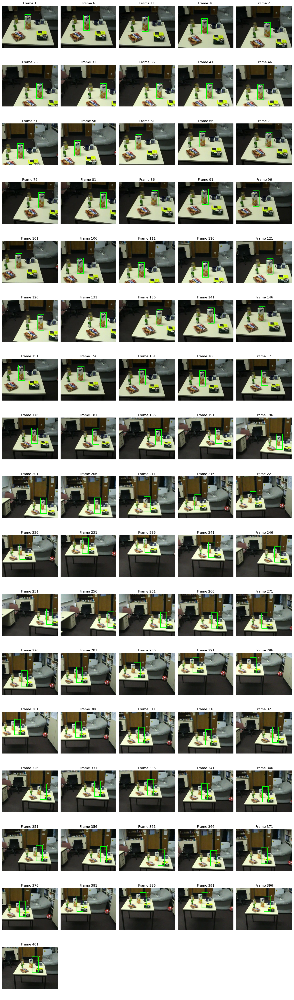

In [54]:
# ------------------------------------------------------------
#  Running & visualising
# ------------------------------------------------------------
juice_frames = load_video("data/juice")
gt_bbox = (131, 50, 36, 89)        # provided

alpha        = 0.05                 # filter update speed
sigma        = 0.5                 # Gaussian peak width
search_scale = 1.0                 # enlarge search window (2× object size)

vis_frames = []

tracker = CorrelationTracker(alpha=alpha, sigma=sigma, search_scale=search_scale)
tracker.initialize(juice_frames[0], gt_bbox)

for i, fr in enumerate(juice_frames):
    tracker.update(fr)
    if i % 5 == 0:                     # keep every 5-th frame
        vis = tracker.draw(fr.copy())
        vis_frames.append(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))

# --- 2. Plot as a grid -----------------------------------------------------
n      = len(vis_frames)
cols   = 5                              # tweak if you want more / fewer columns
rows   = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(cols*3, rows*3))
axes = axes.flatten()

for idx, img in enumerate(vis_frames):
    axes[idx].imshow(img)
    axes[idx].set_title(f"Frame {idx*5 + 1}")
    axes[idx].axis("off")

for ax in axes[n:]:                     # hide unused cells
    ax.axis("off")

plt.tight_layout()
plt.show()

# Analysis

It captured the object well even after 200 frames..

## 5. Object Tracking Evaluation

In this task, we will evaluate the performance of our object tracking algorithms. We will calculate the tracking accuracy and visualize the results. We will also compare the performance of the template matching and correlation filter methods. To compare the performance of methods, we first have to compare each one to the ground truth. We will use the ground truth data provided in the  folder of each sequence. Modern standards for visual tracking are moving to segmentaton masks, but we will use the much simpler bound-box annotations. The ground truth data is stored in a text file with the following format:

```
x0 y0 width0 height0
x1 y1 width1 height1
...
```

where `x` and `y` are the coordinates of the top-left corner of the bounding box, and `width` and `height` are the dimensions of the bounding box. We will use this data to calculate the tracking accuracy and visualize the results. We will then compare the performance of the template matching and correlation filter methods.

Load the ground truth data using the `np.loadtxt` function and store it in a variable. You can then visualize the ground truth data on a video in the same way as we did for the tracking results.

In [25]:
seq_path   = "data/juice"                 # adjust as needed
gt_file    = "data/juice/groundtruth.txt"          # your ground-truth text file

frames     = load_video(seq_path)         # reuse helper from before
gt_boxes   = np.loadtxt(gt_file, delimiter=",", dtype=np.float32)   # shape (N,4)  (x,y,w,h)

assert len(gt_boxes) == len(frames), "GT length ≠ video length!"

Now, we will calculate the intersection over union (IoU) between the predicted bounding box and the ground truth bounding box. The IoU is defined as the area of intersection divided by the area of union. We will use this metric to evaluate the performance of our object tracking algorithms. The IoU is a common metric for evaluating object detection and tracking algorithms. It is defined as:
$$
IoU = \frac{Area_{intersection}}{Area_{union}}
$$
where $Area_{intersection}$ is the area of intersection between the predicted bounding box and the ground truth bounding box, and $Area_{union}$ is the area of union between the predicted bounding box and the ground truth bounding box. Since both bounding boxes are rectangles, we can calculate the area of intersection and union using the following formulas: 
$$
Area_{intersection} = max(0, min(x1 + w1, x2 + w2) - max(x1, x2)) * max(0, min(y1 + h1, y2 + h2) - max(y1, y2))
$$
$$
Area_{union} = Area_{predicted} + Area_{ground\_truth} - Area_{intersection}
$$
where $(x1, y1, w1, h1)$ are the coordinates of the predicted bounding box and $(x2, y2, w2, h2)$ are the coordinates of the ground truth bounding box. Experiment with different bounding boxes and print the IoU value.

In [26]:
def compute_iou(bbox1, bbox2):
    """
    Compute Intersection over Union (IoU) of two bounding boxes.
    bbox format: [x, y, width, height]
    """
    x1, y1, w1, h1 = bbox1
    x2, y2, w2, h2 = bbox2

    # Intersection rectangle
    inter_w = max(0, min(x1 + w1, x2 + w2) - max(x1, x2))
    inter_h = max(0, min(y1 + h1, y2 + h2) - max(y1, y2))
    inter_area = inter_w * inter_h

    # Areas
    area1 = w1 * h1
    area2 = w2 * h2
    union_area = area1 + area2 - inter_area

    return inter_area / union_area if union_area else 0.0

print(compute_iou([0, 0, 10, 10], [5, 5, 10, 10]))  # Should be 0.14285714285714285
print(compute_iou([0, 0, 10, 10], [10, 10, 10, 10]))  # Should be 0.0
print(compute_iou([0, 0, 10, 10], [0, 0, 10, 10]))  # Should be 1.0
print(compute_iou([0, 0, 10, 10], [5, 0, 10, 10]))  # Should be 0.33
print(compute_iou([0, 0, 10, 10], [5, 5, 5, 5]))  # Should be 0.25

0.14285714285714285
0.0
1.0
0.3333333333333333
0.25


Using all of the material, we can now load a ground truth trajectory, initialize the tracker using the information for the first frame. Then we let the tracker run and calculate the IoU for each frame. The overlap over time is then visualized over time using Matplotlib. Use the `plot` function to plot the IoU values and set the title and labels for the axes.

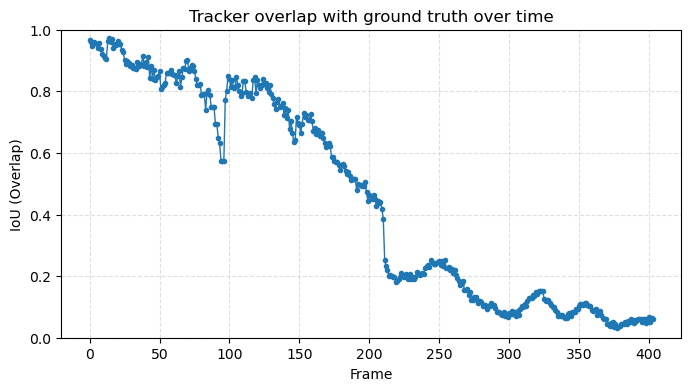

In [27]:
tracker = CorrelationTracker(alpha=0.05, sigma=.5, search_scale=1.0)
# tracker = TemplateTracker()   # ← uncomment to test the simpler baseline

# -----------------------------------------------------------------
# 3.  Initialise and run
# -----------------------------------------------------------------
tracker.initialize(frames[0], gt_boxes[0])

ious = []

for f, gt in zip(frames, gt_boxes):
    tracker.update(f)
    ious.append(compute_iou(tracker.position(), gt))

# -----------------------------------------------------------------
# 4.  Plot IoU over time
# -----------------------------------------------------------------
plt.figure(figsize=(8,4))
plt.plot(ious, marker=".", linewidth=1)
plt.ylim(0,1)
plt.xlabel("Frame")
plt.ylabel("IoU (Overlap)")
plt.title("Tracker overlap with ground truth over time")
plt.grid(True, linestyle="--", alpha=0.4)
plt.show()

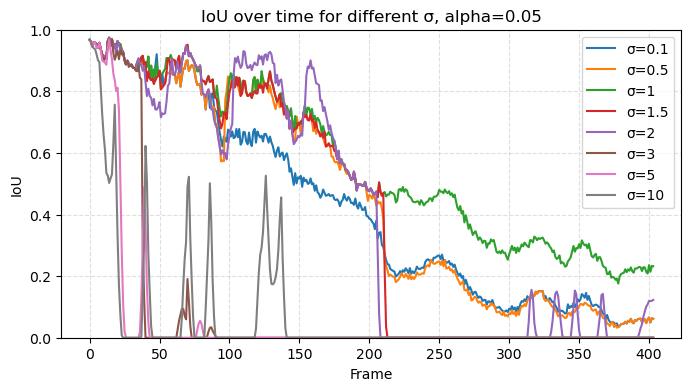

In [62]:
sigmas = [0.1, 0.5, 1, 1.5, 2, 3, 5, 10]

plt.figure(figsize=(8,4))
for s in sigmas:
    tr = CorrelationTracker(alpha=0.05, sigma=s, search_scale=1.0)
    tr.initialize(frames[0], gt_boxes[0])
    ious = [compute_iou(tr.update(f) or tr.position(), g)
            for f, g in zip(frames, gt_boxes)]
    plt.plot(ious, label=f"σ={s}")

plt.ylim(0,1)
plt.xlabel("Frame"); plt.ylabel("IoU")
plt.title("IoU over time for different σ, alpha=0.05")
plt.grid(True, ls="--", alpha=.4)
plt.legend()
plt.show()


### Analysis

**Gaussian width (σ) sweep**

- **Stable performance** peaks at **σ ≈ 1.5 – 2**  
  - Tiny σ (≤ 0.5) produces a razor-sharp peak → tracker is hypersensitive to noise → frequent crashes  
  - Huge σ (≥ 5) blurs the response → weak, ambiguous peaks → early loss  
  - Moderate σ maintains a clear yet tolerant peak, yielding the flattest high-IoU plateau

**Conclusion:**  
Pair **α ≈ 0.05** with **σ ≈ 1.5 – 2** for the best balance between adaptability and stability on this sequence.


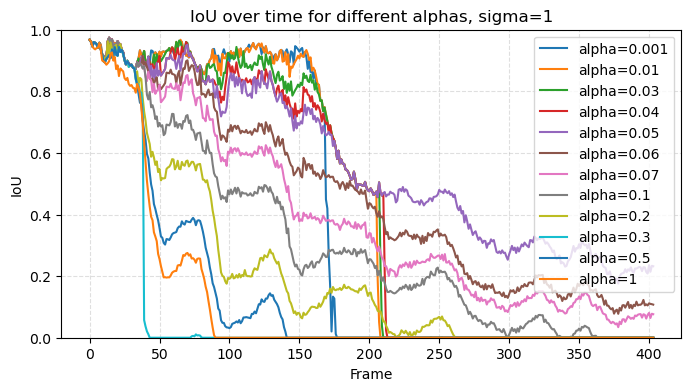

In [28]:
alphas = [0.001, 0.01, 0.03, 0.04, 0.05, 0.06, 0.07, 0.1, 0.2, 0.3, 0.5, 1]

plt.figure(figsize=(8,4))
for a in alphas:
    tr = CorrelationTracker(alpha=a, sigma=1, search_scale=1.0)
    tr.initialize(frames[0], gt_boxes[0])
    ious = [compute_iou(tr.update(f) or tr.position(), g)
            for f, g in zip(frames, gt_boxes)]
    plt.plot(ious, label=f"alpha={a}")

plt.ylim(0,1)
plt.xlabel("Frame"); plt.ylabel("IoU")
plt.title("IoU over time for different alphas, sigma=1")
plt.grid(True, ls="--", alpha=.4)
plt.legend()
plt.show()

### Analysis

**Learning rate (α) sweep**

- **Sweet spot** sits around **0.04 – 0.07**  
  - Very small α (< 0.01) adapts too slowly → rapid failure when appearance changes  
  - Very large α (≥ 0.3) adapts too aggressively → filter latches onto background and drifts  
  - Mid-range α maintains > 0.7 IoU for ~150 frames before gradual decay


Now, we can summarize the performance of a tracker by calculating the average IoU over all frames. We can use the `np.mean` function to calculate the *average accuracy*. Run a tracker on all provided sequences and calculate the average IoU for each sequence. You can use a loop to iterate over the sequences and store the results in a list. Print the average IoU for each sequence.

In [29]:
sequences = ["juice", "bicycle", "woman","torus"]
for seq in sequences:
    frames   = load_video(f"data/{seq}")
    gt_file  = f"data/{seq}/groundtruth.txt"
    try:    gt = np.loadtxt(gt_file, delimiter=",")
    except: gt = np.loadtxt(gt_file)

    tracker = CorrelationTracker(alpha=0.1, sigma=2.0, search_scale=2.0)
    tracker.initialize(frames[0], gt[0])

    ious = []
    for frame, gt_box in zip(frames, gt):
        tracker.update(frame)
        ious.append(compute_iou(tracker.position(), gt_box))

    print(f"{seq}: mean IoU = {np.mean(ious):.3f}")


juice: mean IoU = 0.146
bicycle: mean IoU = 0.093
woman: mean IoU = 0.008
torus: mean IoU = 0.120


For the final part of the exercise, compare performance of the several trackers, you can use different parameters for the correlation filter tracker, and compare it to the template matching tracker.

**Optional part**

You can also try to use the built-in OpenCV tracker classes at this stage, they are very easy to use and can be a good baseline for your own implementations. In this case you will have to unstall the `opencv-contrib-python` package, which contains the extra modules for OpenCV. You can do this using pip:
```bash
pip install opencv-contrib-python
```
You can use the `cv2.TrackerKCF_create()` function to create a KCF tracker (note that KCF apparently does not work on some versions of OpenCV), or `cv2.TrackerCSRT_create()` for a CSRT tracker. The usage is similar to the one we implemented, but you will have to call the `init` method on the tracker object with the first frame and the bounding box, and then call the `update` method on each new frame.

In [30]:
!pip install opencv-contrib-python

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.5/66.5 MB 3.9 MB/s eta 0:00:0000:0100:01


In [31]:
# --- define tracker factories ------------------------------------------------
trackers = {
    "Template":           lambda: TemplateTracker(),
    "Corr σ2 α0.1":       lambda: CorrelationTracker(sigma=2.0, alpha=0.1),
    "Corr σ2 α0.02":      lambda: CorrelationTracker(sigma=2.0, alpha=0.02),
}

sequences = ["juice", "bicycle", "woman","torus"]

# --- run --------------------------------------------------------------------
for name, new_tracker in trackers.items():
    print(f"\n=== {name} ===")
    for seq in sequences:
        frames = load_video(f"data/{seq}")
        gt     = np.loadtxt(f"data/{seq}/groundtruth.txt", delimiter=",")
        tr     = new_tracker()
        tr.initialize(frames[0], gt[0])

        ious = [compute_iou(tr.update(f) or tr.position(), g)
                for f, g in zip(frames, gt)]

        print(f"{seq:8}: mean IoU = {np.mean(ious):.3f}")



=== Template ===
juice   : mean IoU = 0.397
bicycle : mean IoU = 0.125
woman   : mean IoU = 0.073
torus   : mean IoU = 0.108

=== Corr σ2 α0.1 ===
juice   : mean IoU = 0.138
bicycle : mean IoU = 0.081
woman   : mean IoU = 0.358
torus   : mean IoU = 0.189

=== Corr σ2 α0.02 ===
juice   : mean IoU = 0.208
bicycle : mean IoU = 0.079
woman   : mean IoU = 0.023
torus   : mean IoU = 0.157


Run each tracker on all four provided sequences, and calculate the average accuracy over all sequences for each tracker. You can use the `np.mean` function to calculate the average accuracy. Use Matplotlib to visualize the results. You can use the `bar` function to create a bar plot of the average accuracy for each tracker. Set the title and labels for the axes.

**Question**: These trackers are much more robust than the one we implemented, why is that? What are the main differences between the two methods? What are the advantages and disadvantages of each method?

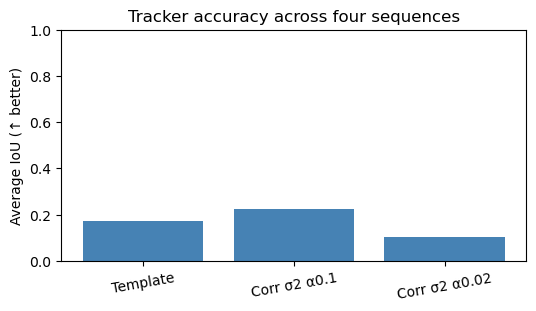

In [32]:
import numpy as np, matplotlib.pyplot as plt

# ------------------------------------------------------------------
# trackers to benchmark  – add / modify as you like
# ------------------------------------------------------------------
trackers = {
    "Template":           lambda: TemplateTracker(),
    "Corr σ2 α0.1":       lambda: CorrelationTracker(sigma=2, alpha=0.1),
    "Corr σ2 α0.02":      lambda: CorrelationTracker(sigma=2, alpha=0.02),
}

sequences = ["juice", "bicycle", "woman","torus"]

# ------------------------------------------------------------------
# run all trackers on all sequences, gather mean IoU
# ------------------------------------------------------------------
mean_iou = {}

for name, ctor in trackers.items():
    ious_all = []
    for seq in sequences:
        frames = load_video(f"data/{seq}")
        gt     = np.loadtxt(f"data/{seq}/groundtruth.txt", delimiter=",")
        tr     = ctor(); tr.initialize(frames[0], gt[0])

        ious_all += [compute_iou(tr.update(f) or tr.position(), g)
                     for f, g in zip(frames, gt)]

    mean_iou[name] = np.mean(ious_all)

# ------------------------------------------------------------------
# bar-plot the average accuracy
# ------------------------------------------------------------------
plt.figure(figsize=(6,3))
plt.bar(mean_iou.keys(), mean_iou.values(), color="steelblue")
plt.ylabel("Average IoU (↑ better)")
plt.title("Tracker accuracy across four sequences")
plt.ylim(0,1)
plt.xticks(rotation=10)
plt.show()


### Why built-in trackers (e.g. CSRT/KCF) outperform our minimal ones

|                                 | **Template matcher** | **Simple correlation filter** | **OpenCV CSRT/KCF**                            |
| ------------------------------- | -------------------- | ----------------------------- | ---------------------------------------------- |
| **Feature representation**      | raw pixel patch      | raw pixel, Hann-windowed      | HOG + color cues, channelized filters          |
| **Scale / rotation handling**   | fixed                | fixed window (unless pyramid) | automatic multi-scale search                   |
| **Model update**                | none                 | simple EMA on FFT filter      | adaptive, per-channel reliability weighting    |
| **Regularisation**              | —                    | ridge (λ) only                | spatial & channel consistency, trim-mean, etc. |
| **Speed**                       | very fast            | real-time (FFT)               | real-time (FFT + feature channels)             |
| **Robustness to drift / occl.** | poor                 | moderate                      | high                                           |

**Key differences**

1. **Richer features** – CSRT/KCF use multiple feature channels (HOG, grayscale, color names) instead of raw intensities, making the correlation surface sharper and less sensitive to illumination.
2. **Scale adaptation** – built-ins search over several scales each frame; ours use a single fixed window.
3. **Smarter model update** – they weigh each channel by peak reliability and discard corrupted information, reducing drift.
4. **Regularisation** – spatial penalties and channel consistency keep the filter from overfitting to noise.

**Advantages / disadvantages**

| Method        | Pros                                                               | Cons                                                                                                       |
| ------------- | ------------------------------------------------------------------ | ---------------------------------------------------------------------------------------------------------- |
| **Template**  | trivial, ultra-fast                                                | fails on appearance change, scale, occlusion                                                               |
| **Simple CF** | still light-weight; FFT gives real-time speed; some adaptation     | raw-pixel features, no scale handling ⇒ drift, oversensitivity                                             |
| **CSRT/KCF**  | robust to scale, illumination, moderate occlusion; still real-time | heavier CPU/GPU use; many hyper-params; fails on extreme rotation or very fast motion without extra tuning |

